# Required Pypi

In [1]:
!pip install librosa
!pip install matplotlib
!pip install pandas
!pip install seaborn
!pip install plotly
!pip install xgboost


[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: python.exe -m pip install --upgrade pip


# Required libraries

In [1]:
import pandas as pd
import librosa
import os
import numpy as np
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 


# My first work is audio files convert to csv files

In [2]:


class Data:
    def __init__(self, data,music_folder,all_csv_files):
        self.data = data
        self.music_folder = music_folder
        self.all_csv_files = all_csv_files
    
    def wav_to_df(self):
        file_list = os.listdir(f'genres/{self.data}')
        dfs = []  # create an empty list to store the DataFrames
        for file_name in file_list:
            if file_name != '.ipynb_checkpoints':
                y, sr = librosa.load(f'genres/{self.data}/{file_name}', sr=45600)
                data_f = {
                    'music_name': [file_name],
                    'load_arr': [y],
                    'sample_rate': [sr],
                    'genre':[self.data]
                    
                }
                df = pd.DataFrame(data_f)
                dfs.append(df)  
        result_df = pd.concat(dfs, ignore_index=True)
        result_df.to_csv(f'{self.data}.csv', index=False)
        return result_df
    
    def all_csv_to_csv(self):
        file_list = os.listdir(self.music_folder)
        combined_df = pd.DataFrame()
        for file_name in file_list:
            if file_name != '.ipynb_checkpoints':
                file_path = f'{self.music_folder}/{file_name}'
                df = pd.read_csv(file_path)
                combined_df = pd.concat([combined_df, df], ignore_index=True)
            combined_df.to_csv(f'{self.all_csv_files}.csv', index=False)


# a = Data(data='blues',music_folder=None,all_csv_files=None)
# a.wav_to_df()
# b=Data(data='pop',music_folder=None,all_csv_files=None)
# b.wav_to_df()
# c = Data(data='classical',music_folder=None,all_csv_files=None)
# c.wav_to_df()
# d = Data(data='country',music_folder=None,all_csv_files=None)
# d.wav_to_df()
# e = Data(data='disco',music_folder=None,all_csv_files=None)
# e.wav_to_df()
# f = Data(data='hiphop',music_folder=None,all_csv_files=None)
# f.wav_to_df()
# g = Data(data='jazz',music_folder=None,all_csv_files=None)
# g.wav_to_df()
# h = Data(data='metal',music_folder=None,all_csv_files=None)
# h.wav_to_df()
# i = Data(data='reggae',music_folder=None,all_csv_files=None)
# i.wav_to_df()
# j = Data(data='rock',music_folder=None,all_csv_files=None)
# j.wav_to_df()
# all_music = Data(data='blues',music_folder='music_csv_files',all_csv_files='all_music')
# all_music.all_csv_to_csv()



In [3]:
df=pd.read_csv("all_music.csv")
df

,music_name,load_arr,sample_rate,genre
0,blues.00000.wav,[ 0.0071735 0.01332307 0.01644646 ... -0.07...,45600,blues
1,blues.00001.wav,[ 0.00330044 0.00474684 0.00434459 ... -0.18...,45600,blues
2,blues.00002.wav,[ 0.01849134 0.03540435 0.04709583 ... -0.12...,45600,blues
3,blues.00003.wav,[-0.01265346 -0.02290098 -0.0300912 ... 0.01...,45600,blues
4,blues.00004.wav,[-0.0060655 -0.00889027 -0.00926177 ... 0.06...,45600,blues
...,...,...,...,...
995,rock.00095.wav,[-0.07962106 -0.11921073 -0.1241063 ... -0.10...,45600,rock
996,rock.00096.wav,[ 0.06971205 0.10022736 0.10351291 ... 0.00...,45600,rock
997,rock.00097.wav,[-0.0328739 -0.04569552 -0.03905107 ... 0.33...,45600,rock
998,rock.00098.wav,[0.08290517 0.12884933 0.14381197 ... 0.024418...,45600,rock


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   music_name   1000 non-null   object
 1   load_arr     1000 non-null   object
 2   sample_rate  1000 non-null   int64 
 3   genre        1000 non-null   object
dtypes: int64(1), object(3)
memory usage: 31.4+ KB


# Second work is use the other dataset

In [25]:
def load_dataset():
    return pd.read_csv('features_3_sec.csv')
df = load_dataset()
df

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.0.wav,66149,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,blues.00000.1.wav,66149,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,blues.00000.2.wav,66149,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,blues.00000.3.wav,66149,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,blues.00000.4.wav,66149,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9985,rock.00099.5.wav,66149,0.349126,0.080515,0.050019,0.000097,1499.083005,164266.886443,1718.707215,85931.574523,...,42.485981,-9.094270,38.326839,-4.246976,31.049839,-5.625813,48.804092,1.818823,38.966969,rock
9986,rock.00099.6.wav,66149,0.372564,0.082626,0.057897,0.000088,1847.965128,281054.935973,1906.468492,99727.037054,...,32.415203,-12.375726,66.418587,-3.081278,54.414265,-11.960546,63.452255,0.428857,18.697033,rock
9987,rock.00099.7.wav,66149,0.347481,0.089019,0.052403,0.000701,1346.157659,662956.246325,1561.859087,138762.841945,...,78.228149,-2.524483,21.778994,4.809936,25.980829,1.775686,48.582378,-0.299545,41.586990,rock
9988,rock.00099.8.wav,66149,0.387527,0.084815,0.066430,0.000320,2084.515327,203891.039161,2018.366254,22860.992562,...,28.323744,-5.363541,17.209942,6.462601,21.442928,2.354765,24.843613,0.675824,12.787750,rock


In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9990 entries, 0 to 9989
Data columns (total 60 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   filename                 9990 non-null   object 
 1   length                   9990 non-null   int64  
 2   chroma_stft_mean         9990 non-null   float64
 3   chroma_stft_var          9990 non-null   float64
 4   rms_mean                 9990 non-null   float64
 5   rms_var                  9990 non-null   float64
 6   spectral_centroid_mean   9990 non-null   float64
 7   spectral_centroid_var    9990 non-null   float64
 8   spectral_bandwidth_mean  9990 non-null   float64
 9   spectral_bandwidth_var   9990 non-null   float64
 10  rolloff_mean             9990 non-null   float64
 11  rolloff_var              9990 non-null   float64
 12  zero_crossing_rate_mean  9990 non-null   float64
 13  zero_crossing_rate_var   9990 non-null   float64
 14  harmony_mean            

In [27]:
def summarize_dataset():
    print(f"Dataset first 10 rows:\n{df.head(10)}")
    print(f"\nDataset shape:\n{df.shape}")
    print(f"\nDataset describe:\n{df.describe}")
summarize_data = summarize_dataset()
summarize_data

Dataset first 10 rows:
            filename  length  chroma_stft_mean  chroma_stft_var  rms_mean   
0  blues.00000.0.wav   66149          0.335406         0.091048  0.130405  \
1  blues.00000.1.wav   66149          0.343065         0.086147  0.112699   
2  blues.00000.2.wav   66149          0.346815         0.092243  0.132003   
3  blues.00000.3.wav   66149          0.363639         0.086856  0.132565   
4  blues.00000.4.wav   66149          0.335579         0.088129  0.143289   
5  blues.00000.5.wav   66149          0.376670         0.089702  0.132618   
6  blues.00000.6.wav   66149          0.379909         0.088827  0.130335   
7  blues.00000.7.wav   66149          0.331880         0.092119  0.140600   
8  blues.00000.8.wav   66149          0.347877         0.094209  0.133130   
9  blues.00000.9.wav   66149          0.358061         0.082957  0.115312   

    rms_var  spectral_centroid_mean  spectral_centroid_var   
0  0.003521             1773.065032          167541.630869  \
1  0.

In [28]:
import matplotlib.pyplot as plt

In [29]:
df.columns

Index(['filename', 'length', 'chroma_stft_mean', 'chroma_stft_var', 'rms_mean',
       'rms_var', 'spectral_centroid_mean', 'spectral_centroid_var',
       'spectral_bandwidth_mean', 'spectral_bandwidth_var', 'rolloff_mean',
       'rolloff_var', 'zero_crossing_rate_mean', 'zero_crossing_rate_var',
       'harmony_mean', 'harmony_var', 'perceptr_mean', 'perceptr_var', 'tempo',
       'mfcc1_mean', 'mfcc1_var', 'mfcc2_mean', 'mfcc2_var', 'mfcc3_mean',
       'mfcc3_var', 'mfcc4_mean', 'mfcc4_var', 'mfcc5_mean', 'mfcc5_var',
       'mfcc6_mean', 'mfcc6_var', 'mfcc7_mean', 'mfcc7_var', 'mfcc8_mean',
       'mfcc8_var', 'mfcc9_mean', 'mfcc9_var', 'mfcc10_mean', 'mfcc10_var',
       'mfcc11_mean', 'mfcc11_var', 'mfcc12_mean', 'mfcc12_var', 'mfcc13_mean',
       'mfcc13_var', 'mfcc14_mean', 'mfcc14_var', 'mfcc15_mean', 'mfcc15_var',
       'mfcc16_mean', 'mfcc16_var', 'mfcc17_mean', 'mfcc17_var', 'mfcc18_mean',
       'mfcc18_var', 'mfcc19_mean', 'mfcc19_var', 'mfcc20_mean', 'mfcc20_var',
  

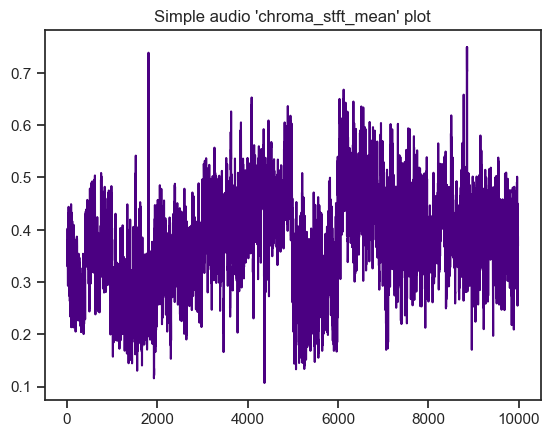

In [30]:
plt.plot(df["chroma_stft_mean"],color="indigo")
plt.title(label="Simple audio 'chroma_stft_mean' plot")
plt.show()

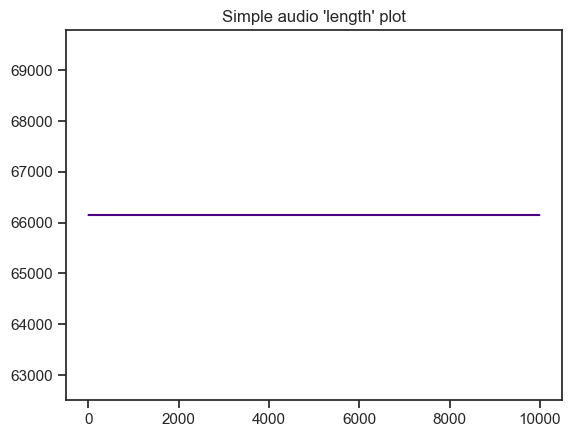

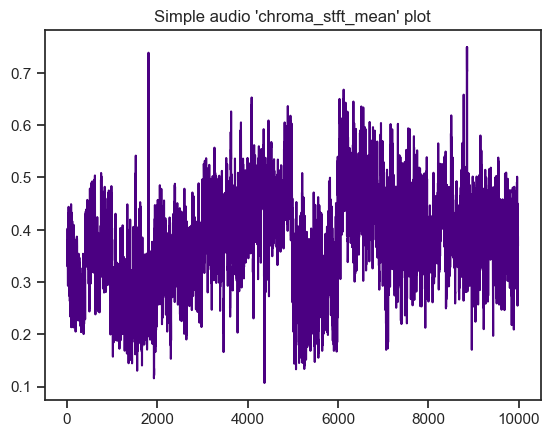

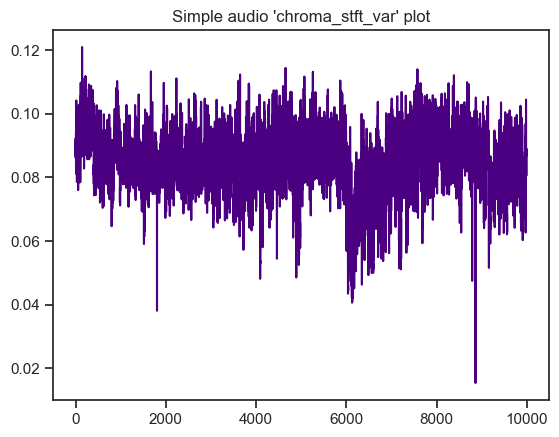

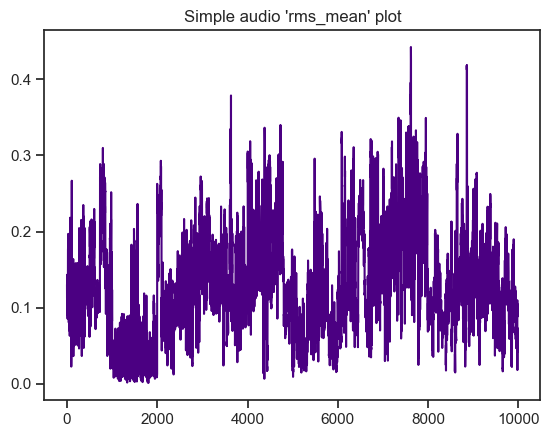

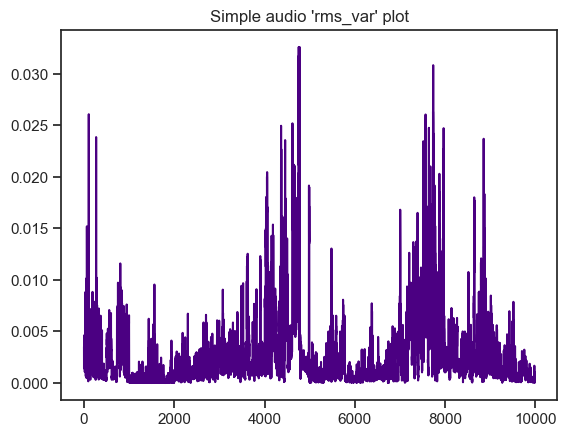

...

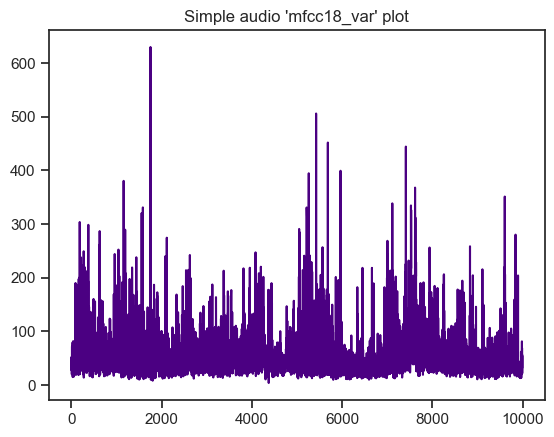

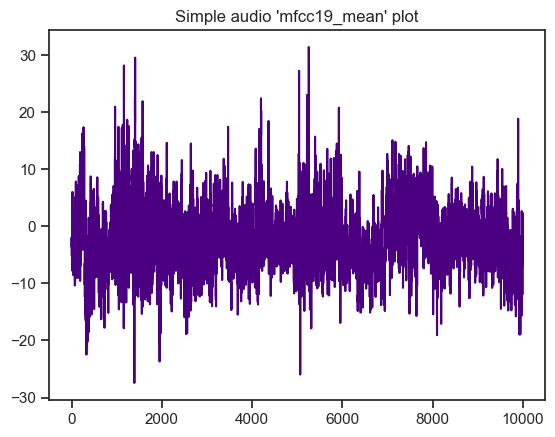

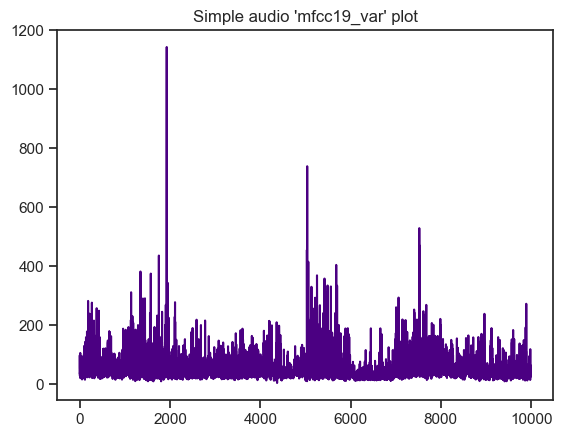

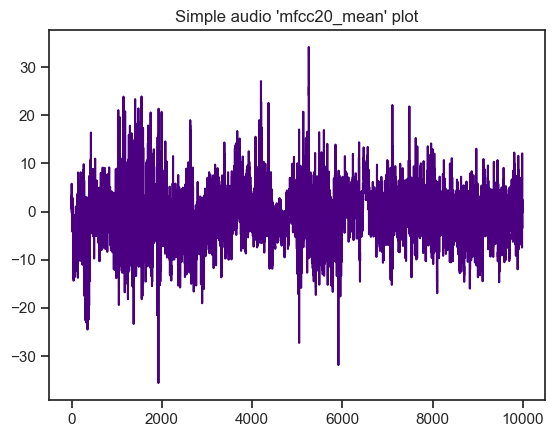

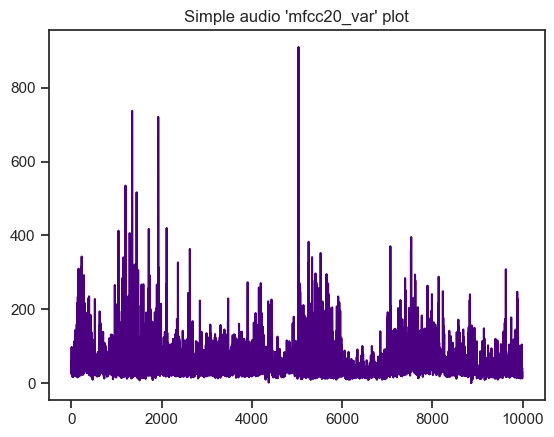

In [31]:
for i in df.columns:
    if i!="filename" and i!="label":
        plt.plot(df[f"{i}"],color="indigo")
        plt.title(label=f"Simple audio '{i}' plot")
        plt.show()

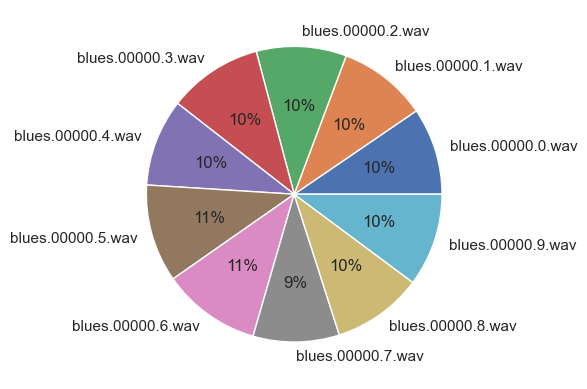

In [32]:
import matplotlib.pyplot as plt

y = df["chroma_stft_mean"].head(10)
mylabels = df["filename"].head(10)

plt.pie(y, labels = mylabels,autopct='%.0f%%')
plt.show() 

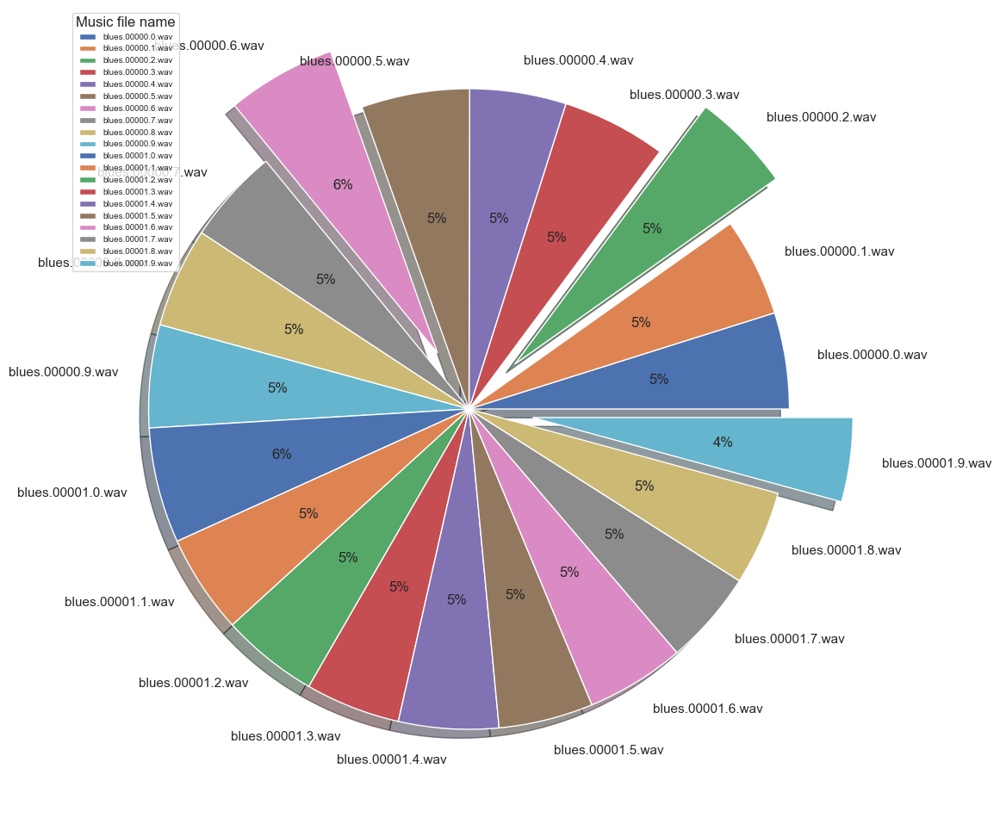

In [33]:
x = df[df["chroma_stft_mean"]!=0]
y = x["chroma_stft_mean"]
plt.figure(figsize=(12,13))
myex = [0,0,0.2,0,0,0,0.2,0,0,0,0,0,0,0,0,0,0,0,0,0.2]
plt.pie(y.head(20),labels=x["filename"].head(20),autopct='%.0f%%',shadow=True,explode=myex)
plt.legend(prop = {'size' : 7},title = "Music file name",loc="upper left")
plt.show()

C:\Users\User\AppData\Local\Temp\ipykernel_74348\2437472064.py:10: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



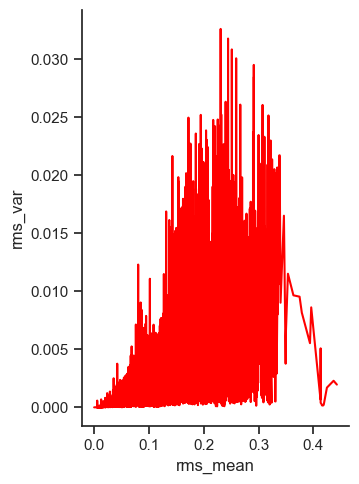

In [34]:
import seaborn as sns
sns.set_theme(style="ticks")

# dots = sns.load_dataset(df)

# Define the palette as a list to specify exact values
palette = sns.color_palette("rocket_r")

# Plot the lines on two facets
sns.relplot(
    data=df,
    x="rms_mean", y="rms_var",
    kind="line", size_order=["T1", "T2"], palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),color="red")
plt.show()

In [165]:
df.columns

Index(['filename', 'length', 'chroma_stft_mean', 'chroma_stft_var', 'rms_mean',
       'rms_var', 'spectral_centroid_mean', 'spectral_centroid_var',
       'spectral_bandwidth_mean', 'spectral_bandwidth_var', 'rolloff_mean',
       'rolloff_var', 'zero_crossing_rate_mean', 'zero_crossing_rate_var',
       'harmony_mean', 'harmony_var', 'perceptr_mean', 'perceptr_var', 'tempo',
       'mfcc1_mean', 'mfcc1_var', 'mfcc2_mean', 'mfcc2_var', 'mfcc3_mean',
       'mfcc3_var', 'mfcc4_mean', 'mfcc4_var', 'mfcc5_mean', 'mfcc5_var',
       'mfcc6_mean', 'mfcc6_var', 'mfcc7_mean', 'mfcc7_var', 'mfcc8_mean',
       'mfcc8_var', 'mfcc9_mean', 'mfcc9_var', 'mfcc10_mean', 'mfcc10_var',
       'mfcc11_mean', 'mfcc11_var', 'mfcc12_mean', 'mfcc12_var', 'mfcc13_mean',
       'mfcc13_var', 'mfcc14_mean', 'mfcc14_var', 'mfcc15_mean', 'mfcc15_var',
       'mfcc16_mean', 'mfcc16_var', 'mfcc17_mean', 'mfcc17_var', 'mfcc18_mean',
       'mfcc18_var', 'mfcc19_mean', 'mfcc19_var', 'mfcc20_mean', 'mfcc20_var',
  

In [38]:
import plotly.express as px
for i in df.columns:
    if i.startswith("mfcc"):
        fig = px.histogram(df, x=f"{i}")
        fig.show()

# Audio To np.array

In [60]:
import IPython
file_list = os.listdir(f'genres/blues')
for file_name in file_list:
    if file_name != '.ipynb_checkpoints':
        y, sr = librosa.load(f'genres/blues/{file_name}', sr=45600)
        print(y)

[ 0.0071735   0.01332307  0.01644646 ... -0.07312676 -0.06151061
 -0.03034332]
[ 0.00330044  0.00474684  0.00434459 ... -0.18871175 -0.14469385
 -0.06621628]
[ 0.01849134  0.03540435  0.04709583 ... -0.12585531 -0.12005397
 -0.06238867]
[-0.01265346 -0.02290098 -0.0300912  ...  0.01336751  0.01131434
  0.00562026]
[-0.0060655  -0.00889027 -0.00926177 ...  0.06252696  0.0526453
  0.02606298]
[-0.02335619 -0.0328693  -0.03006374 ...  0.02032365 -0.00127981
 -0.00543673]
[ 0.17581804  0.26712498  0.2823638  ... -0.4747638  -0.41172794
 -0.20671833]
[0.01234017 0.0145216  0.00858161 ... 0.14681378 0.15592536 0.08606076]
[0.01104344 0.01860601 0.02162309 ... 0.19911063 0.16363536 0.07931924]
[ 0.04473488  0.06490149  0.06415059 ... -0.04384328 -0.03581531
 -0.01746564]
[0.11531855 0.16037583 0.15046947 ... 0.01383239 0.00990143 0.00441929]
[-0.02466057 -0.03679913 -0.03870048 ... -0.04926548 -0.04075954
 -0.02000478]
[0.17837842 0.25692073 0.25065163 ... 0.00165396 0.00821826 0.00589273]
[-

# np.array to Audio :)

In [2]:
import IPython
import librosa
data, sr = librosa.load("genres/blues/blues.00000.wav")
IPython.display.Audio(data,rate=sr)

# Plot blues.00000.wav file :-)

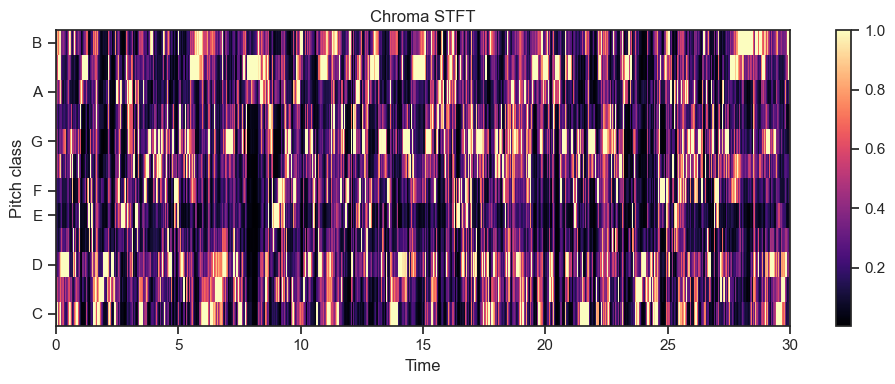

In [122]:
import librosa
import librosa.display
import matplotlib.pyplot as plt

# Load an audio file

# Extract Chroma STFT feature
chroma_stft = librosa.feature.chroma_stft(y=data, sr=sr)

# Display the Chroma STFT feature as an image
plt.figure(figsize=(10, 4))
librosa.display.specshow(chroma_stft, y_axis='chroma', x_axis='time')
plt.colorbar()
plt.title('Chroma STFT')
plt.tight_layout()
plt.show()




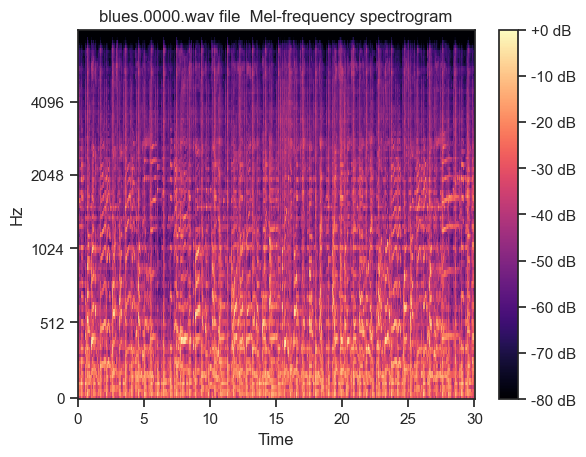

In [130]:
S=librosa.feature.melspectrogram(y=data, sr=sr)
fig, ax = plt.subplots()
S_dB = librosa.power_to_db(S, ref=np.max)
img = librosa.display.specshow(S_dB, x_axis='time',
                         y_axis='mel', sr=sr,
                         fmax=8000, ax=ax)
fig.colorbar(img, ax=ax, format='%+2.0f dB')
ax.set(title='blues.0000.wav file  Mel-frequency spectrogram')
plt.show() 

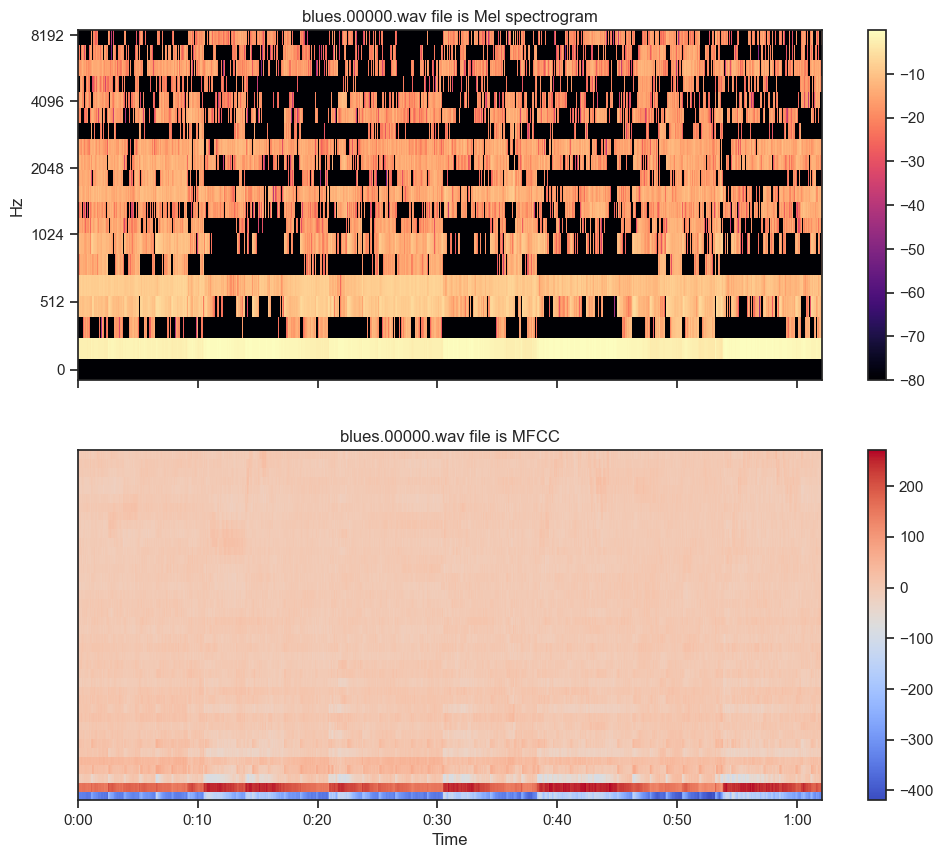

In [139]:
S = librosa.feature.mfcc(y=y, sr=sr)
mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=40)
fig, ax = plt.subplots(nrows=2, sharex=True,figsize=(12,10))
img = librosa.display.specshow(librosa.power_to_db(S, ref=np.max),
                               x_axis='time', y_axis='mel', fmax=8000,ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].set(title='blues.00000.wav file is Mel spectrogram')
ax[0].label_outer()
img = librosa.display.specshow(mfccs, x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])
ax[1].set(title='blues.00000.wav file is MFCC')
plt.show()

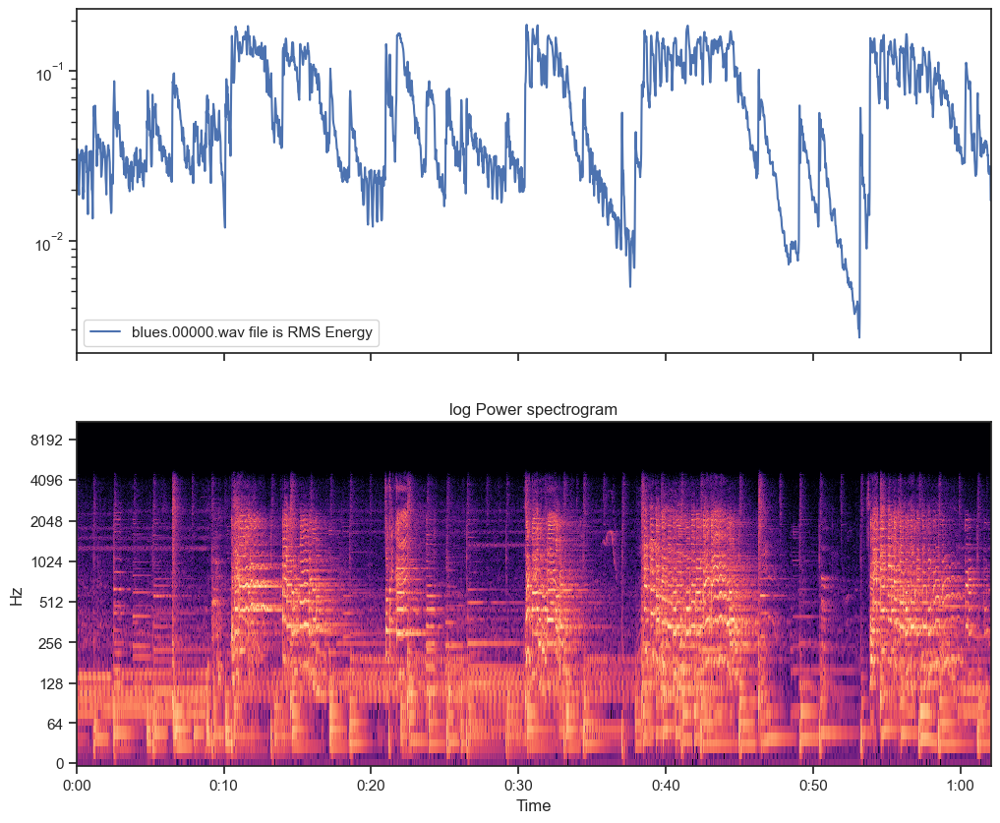

In [153]:
rms = librosa.feature.rms(y=y)
S, phase = librosa.magphase(librosa.stft(y))
rms = librosa.feature.rms(S=S)
fig, ax = plt.subplots(nrows=2, sharex=True,figsize=(12,10))
times = librosa.times_like(rms)
ax[0].semilogy(times, rms[0], label='blues.00000.wav file is RMS Energy')
ax[0].set(xticks=[])
ax[0].legend()
ax[0].label_outer()
librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[1])
ax[1].set(title='log Power spectrogram')
S = librosa.magphase(librosa.stft(y, window=np.ones, center=False))[0]
librosa.feature.rms(S=S)
plt.show()


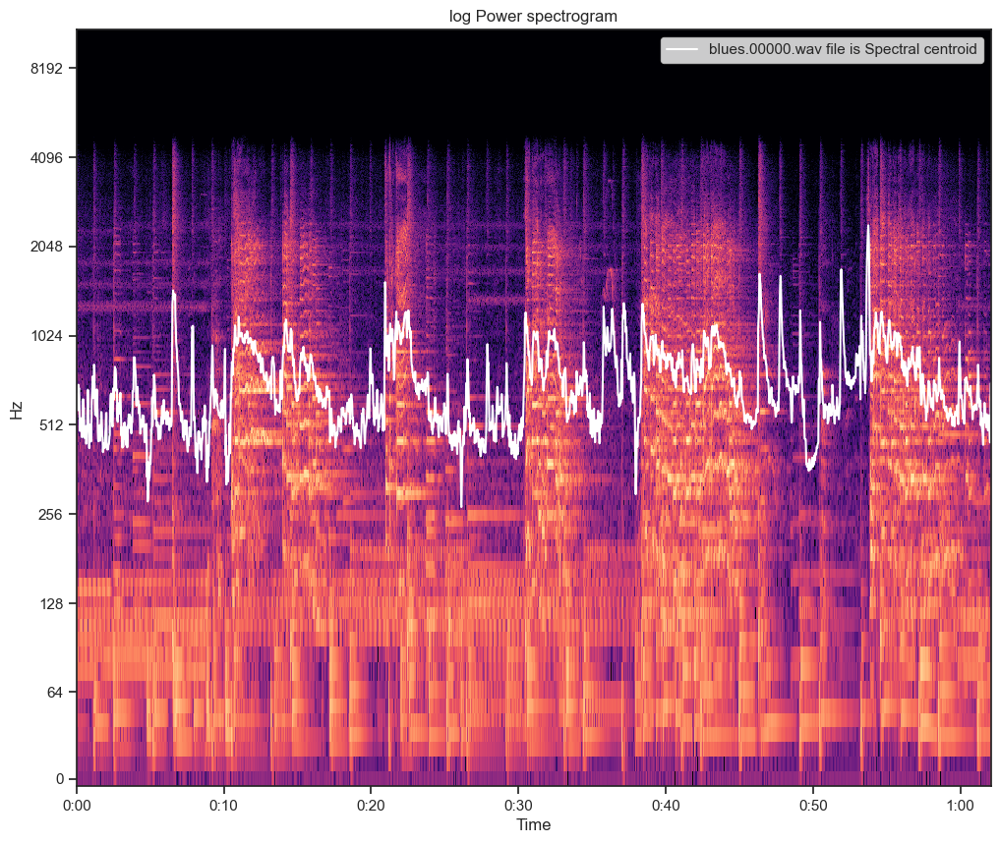

In [158]:
cent = librosa.feature.spectral_centroid(y=y, sr=sr)
S, phase = librosa.magphase(librosa.stft(y=y))
librosa.feature.spectral_centroid(S=S)
times = librosa.times_like(cent)
fig, ax = plt.subplots(figsize=(12,5))
librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax)
ax.plot(times, cent.T, label='blues.00000.wav file is Spectral centroid', color='w')
ax.legend(loc='upper right')
ax.set(title='log Power spectrogram')
plt.show()

# Prediction Part

In [6]:
import pandas as pd
df = pd.read_csv('features_3_sec.csv')


In [7]:
# cols = ["chroma_stft_mean","rms_mean","spectral_centroid_mean","spectral_bandwidth_mean","rolloff_mean","zero_crossing_rate_mean","harmony_mean","perceptr_mean","perceptr_mean","mfcc1_mean","mfcc20_var"]



In [14]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score

# Load the need columns
x = df.drop(["filename","length","label"],axis=1)
y = df["label"]
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(x,y, test_size=0.2,random_state=100)

# Define the classifiers to be used
classifiers = [
    DecisionTreeClassifier(),
    KNeighborsClassifier(),
    GaussianNB(),
    MLPClassifier(),
    SVC(),
]

# Train and evaluate each classifier
for clf in classifiers:
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    print(clf.__class__.__name__, f"->\033[0;31mThe Accuracy score:\033[0m\033[0;34m{accuracy_score(y_test, y_pred)*100}%\033[0m")

DecisionTreeClassifier ->The Accuracy score:66.11611611611612%
KNeighborsClassifier ->The Accuracy score:28.47847847847848%
GaussianNB ->The Accuracy score:42.69269269269269%
MLPClassifier ->The Accuracy score:25.475475475475474%
SVC ->The Accuracy score:28.628628628628626%


In [25]:
import numpy as np
ds = DecisionTreeClassifier()
X_train, X_test, y_train, y_test = train_test_split(x,y, test_size=0.2, random_state=100)
ds.fit(X_train,y_train)
y_pred_ds = ds.predict(X_test)
l = []
for i in y_pred_ds:
    l.append(i)
print(l)

['classical', 'jazz', 'metal', 'disco', 'metal', 'classical', 'rock', 'disco', 'hiphop', 'metal', 'rock', 'blues', 'hiphop', 'metal', 'disco', 'pop', 'country', 'blues', 'pop', 'rock', 'reggae', 'metal', 'blues', 'country', 'pop', 'pop', 'classical', 'jazz', 'hiphop', 'metal', 'reggae', 'blues', 'pop', 'hiphop', 'metal', 'pop', 'jazz', 'reggae', 'country', 'pop', 'blues', 'rock', 'hiphop', 'jazz', 'country', 'rock', 'pop', 'disco', 'jazz', 'hiphop', 'disco', 'rock', 'disco', 'disco', 'metal', 'pop', 'disco', 'jazz', 'rock', 'rock', 'metal', 'country', 'pop', 'metal', 'rock', 'rock', 'jazz', 'classical', 'country', 'country', 'classical', 'metal', 'rock', 'blues', 'classical', 'metal', 'blues', 'blues', 'metal', 'classical', 'jazz', 'reggae', 'jazz', 'blues', 'blues', 'hiphop', 'jazz', 'reggae', 'reggae', 'rock', 'hiphop', 'metal', 'pop', 'disco', 'country', 'metal', 'hiphop', 'reggae', 'disco', 'hiphop', 'blues', 'blues', 'reggae', 'reggae', 'blues', 'disco', 'country', 'jazz', 'reggae

In [26]:
df['length'].unique()

array([66149], dtype=int64)

In [ ]:
#Go my blog post